#### Import relevant packages

In [1]:
import s3fs; import xarray as xr; import numpy as np
import pandas as pd; import scipy
import matplotlib.pyplot as plt; import cartopy.crs as ccrs
import netCDF4 as nc; import datetime as dt
import ocetrac

import dask.array as da
import warnings; import expectexception
warnings.filterwarnings('ignore')
import intake; import pprint

import random
import nc_time_axis; import cftime; import datetime as dt
from scipy.optimize import curve_fit

In [2]:
import datetime

Import seaborn for visualization purposes

In [3]:
import seaborn as sns
sns.set_theme(style="darkgrid")

#### Set our area of interest

In [4]:
# North Pacific latitude and longitude limits (currently, this is a small area)
lat_lim_less = 10. # 30. # can change lat_lim_less to 10
lat_lim_great = 60.

lon_lim_less = 200.
lon_lim_great = 250.

#### Load marine heatwave event files
* Method 1: Use the ensemble mean to calculate SST anomalies
* Method 2: Use linearly detrended SST to calculate SST anomalies
* Method 3: Take a 30 year trend (and then take away that linear trend) as each ensemble member's linear trend estimate (clarification: take the last 40 years --> match OISST) 

In [5]:
# load marine heatwave events
blobby_ensemble_mean_em0 = xr.open_dataset('blobs_ens_0_rad4.nc') # from ensemble member 0 using ensemble mean
blobby_relative_em0 = xr.open_dataset('blobs_ens_0_rad4_rel_itself.nc') # from ensemble member 0 using linearly detrended SST

In [5]:
blobs_detrended_last40years = xr.open_dataset('blobs_detrended_last40years.nc') 
detrended_ens0_last40years = xr.open_dataset('detrended_ens0_last40years.nc') 

In [6]:
detrended_ens0_last40years

<xarray.Dataset>
Dimensions:                        (time: 481, lat: 192, lon: 288)
Coordinates:
  * time                           (time) object 1975-01-01 00:00:00 ... 2015...
  * lat                            (lat) float64 -90.0 -89.06 ... 89.06 90.0
  * lon                            (lon) float64 0.0 1.25 2.5 ... 357.5 358.8
    member_id                      object ...
Data variables:
    __xarray_dataarray_variable__  (time, lat, lon) float64 ...

In [6]:
blobby_ensemble_mean_em0

<xarray.Dataset>
Dimensions:    (lat: 192, lon: 288, time: 1980)
Coordinates:
  * lat        (lat) float64 -90.0 -89.06 -88.12 -87.17 ... 88.12 89.06 90.0
  * lon        (lon) float64 0.0 1.25 2.5 3.75 5.0 ... 355.0 356.2 357.5 358.8
  * time       (time) object 1850-02-01 00:00:00 ... 2015-01-01 00:00:00
    member_id  object ...
    quantile   float64 ...
    month      (time) int64 ...
Data variables:
    labels     (time, lat, lon) float64 ...

In [7]:
blobby_relative_em0

<xarray.Dataset>
Dimensions:    (lat: 192, lon: 288, time: 1980)
Coordinates:
  * lat        (lat) float64 -90.0 -89.06 -88.12 -87.17 ... 88.12 89.06 90.0
  * lon        (lon) float64 0.0 1.25 2.5 3.75 5.0 ... 355.0 356.2 357.5 358.8
  * time       (time) object 1850-02-01 00:00:00 ... 2015-01-01 00:00:00
    member_id  object ...
    quantile   float64 ...
    month      (time) int64 ...
Data variables:
    labels     (time, lat, lon) float64 ...

In [8]:
# blobby_ensemble_mean_em0.labels #radius = 4, minimum area = 40.0, final objects tracked: 4620
# blobby_relative_em0.labels #radius = 4, minimum area = 40.0, final objects tracked: 2717

In [9]:
# load SST anomaly data
SSTA_full = xr.open_dataset('/glade/work/cassiacai/SSTA_full.nc')  # from using ensemble mean
first_10_members_SSTA = SSTA_full.isel(member_id = [0])
# first_10_members_SSTA = SSTA_full.isel(member_id = [0,1,2,3,4,5,6,7,8,9])

# SSTA_itself_ens0 = xr.open_dataset('detrended_ens0.nc') # from ensemble member 0 using linearly detrended SST

In [8]:
SSTA_itself_ens0 = xr.open_dataset('detrended_ens0.nc') # from ensemble member 0 using linearly detrended SST

Combining SSTA and marine heatwave event files

In [9]:
combined = xr.combine_by_coords([first_10_members_SSTA.isel(member_id = 0),blobby_ensemble_mean_em0])
event_NEP = combined.groupby(combined.labels) # 4620 groups with labels 1.0, 2.0, ..., 4.619e+03, 4.62e+03.

In [9]:
combined_rel = xr.combine_by_coords([SSTA_itself_ens0, blobby_relative_em0])
event_NEP_rel = combined_rel.groupby(combined_rel.labels) # 2717 groups with labels 1.0, 2.0, ..., 2.717e+03.

In [7]:
combined_last40_detrendlin = xr.combine_by_coords([detrended_ens0_last40years, blobs_detrended_last40years])
event__last40_detrendlin = combined_last40_detrendlin.groupby(combined_last40_detrendlin.labels) # 242 groups

In [8]:
file = event__last40_detrendlin #event_NEP_rel

label_ls = []; time_begin_ls = []; time_end_ls = []; duration_ls = []; 
intense_mean = []; intense_max = []; intense_min = [];intense_cumu = []
coords_ls = []; cell_area_ls = []; lat_ls = []; lon_ls = []

for l, ent in file:        
    label_ls.append(l)
    groupedby_by_time = ent.groupby(ent.time)
    time_begin = str(ent.time[0].values); time_begin_ls.append(time_begin)
    time_end = str(ent.time[-1].values); time_end_ls.append(time_end)
        
    duration = len(ent.groupby("time")); duration_ls.append(duration)

    temp_intense_mean = []; temp_intense_max = []; temp_intense_min = []; temp_intense_cumu = []
    temp_coords = []; temp_cell_area = []; temp_lat = []; temp_lon = []
    for n, gro in groupedby_by_time:
        lat = gro.lat.values
        lon = gro.lon.values
        time = gro.time.values
                        
        intensity_mean_val = gro['__xarray_dataarray_variable__'].values.mean(); temp_intense_mean.append(intensity_mean_val)
        intensity_max_val = gro['__xarray_dataarray_variable__'].values.max(); temp_intense_max.append(intensity_max_val)
        intensity_min_val = gro['__xarray_dataarray_variable__'].values.min(); temp_intense_min.append(temp_intense_min)
        intensity_cumulative_val = gro['__xarray_dataarray_variable__'].values.sum(); temp_intense_cumu.append(intensity_cumulative_val)

        coords = list(zip(lat, lon)); temp_coords.append(coords)
        temp_lat.append(lat); temp_lon.append(lon)
        y,x=zip(*coords)
        dlon = [np.cos(y[c]*np.pi/180)*(111.320*1) for c in np.arange(0, len(coords))]
        dlat = (110.574 *1) * np.ones(len(dlon))
        cell_area = [np.sum(dlon[c]*dlat[c]) for c in np.arange(0, len(coords))]; temp_cell_area.append(np.sum(cell_area))

    intense_mean.append(temp_intense_mean)
    intense_max.append(temp_intense_max)
    intense_min.append(temp_intense_min) 
    intense_cumu.append(temp_intense_cumu)
    coords_ls.append(temp_coords)
    cell_area_ls.append(temp_cell_area)
    lat_ls.append(temp_lat)
    lon_ls.append(temp_lon)
        
    begin_dates_list = [dt.datetime.strptime(date, '%Y-%m-%d %H:%M:%S').date() for date in time_begin_ls]
    
    end_dates_list = [dt.datetime.strptime(date, '%Y-%m-%d %H:%M:%S').date() for date in time_end_ls]

my_df_rel = pd.DataFrame(zip(label_ls, begin_dates_list, end_dates_list, duration_ls,
                         intense_mean, intense_max, intense_min, intense_cumu,
                         coords_ls, cell_area_ls, lat_ls, lon_ls, time_begin_ls, time_end_ls), 
                     columns = ['label', 'time_begin', 'time_end', 'duration',
                                'intense_mean', 'intense_max', 'intense_min','intense_cumu',
                                'coords','cell_area','lat','lon', 'time_begin_ls','time_end_ls'])

my_xarray_rel = my_df_rel.to_xarray() 

In [9]:
my_xarray_rel

<xarray.Dataset>
Dimensions:        (index: 242)
Coordinates:
  * index          (index) int64 0 1 2 3 4 5 6 7 ... 235 236 237 238 239 240 241
Data variables: (12/14)
    label          (index) float64 1.0 2.0 3.0 4.0 ... 239.0 240.0 241.0 242.0
    time_begin     (index) object 1975-01-01 1975-01-01 ... 2015-01-01
    time_end       (index) object 1975-06-01 1975-01-01 ... 2015-01-01
    duration       (index) int64 6 1 9 6 2 7 9 2 17 13 ... 5 1 2 14 1 1 16 2 1 1
    intense_mean   (index) object [1.006577330455464, 1.2313942680746968, 1.4...
    intense_max    (index) object [1.9071057584885125, 2.3259634643455342, 2....
    ...             ...
    coords         (index) object [[(-51.361256544502616, 130.0), (-51.361256...
    cell_area      (index) object [8326488.004199062, 6953795.599980992, 6342...
    lat            (index) object [array([-51.36125654, -51.36125654, -51.361...
    lon            (index) object [array([130.  , 131.25, 132.5 , 133.75, 135...
    time_begin_ls  (index) object '1975-01-01 00:00:00' ... '2015-01-01 00:00...
    time_end_ls    (index) object '1975-06-01 00:00:00' ... '2015-01-01 00:00...

In [12]:
%%time

file = event_NEP

label_ls = []; time_begin_ls = []; time_end_ls = []; duration_ls = []; 
intense_mean = []; intense_max = []; intense_min = [];intense_cumu = []
coords_ls = []; cell_area_ls = []; lat_ls = []; lon_ls = []

for l, ent in file:        
    label_ls.append(l)
    groupedby_by_time = ent.groupby(ent.time)
    time_begin = str(ent.time[0].values); time_begin_ls.append(time_begin)
    time_end = str(ent.time[-1].values); time_end_ls.append(time_end)
        
    duration = len(ent.groupby("time")); duration_ls.append(duration)

    temp_intense_mean = []; temp_intense_max = []; temp_intense_min = []; temp_intense_cumu = []
    temp_coords = []; temp_cell_area = []; temp_lat = []; temp_lon = []
    for n, gro in groupedby_by_time:
        lat = gro.lat.values
        lon = gro.lon.values
        time = gro.time.values
                        
        intensity_mean_val = gro['SST'].values.mean(); temp_intense_mean.append(intensity_mean_val)
        intensity_max_val = gro['SST'].values.max(); temp_intense_max.append(intensity_max_val)
        intensity_min_val = gro['SST'].values.min(); temp_intense_min.append(temp_intense_min)
        intensity_cumulative_val = gro['SST'].values.sum(); temp_intense_cumu.append(intensity_cumulative_val)

        coords = list(zip(lat, lon)); temp_coords.append(coords)
        temp_lat.append(lat); temp_lon.append(lon)
        y,x=zip(*coords)
        dlon = [np.cos(y[c]*np.pi/180)*(111.320*1) for c in np.arange(0, len(coords))]
        dlat = (110.574 *1) * np.ones(len(dlon))
        cell_area = [np.sum(dlon[c]*dlat[c]) for c in np.arange(0, len(coords))]; temp_cell_area.append(np.sum(cell_area))

    intense_mean.append(temp_intense_mean)
    intense_max.append(temp_intense_max)
    intense_min.append(temp_intense_min) 
    intense_cumu.append(temp_intense_cumu)
    coords_ls.append(temp_coords)
    cell_area_ls.append(temp_cell_area)
    lat_ls.append(temp_lat)
    lon_ls.append(temp_lon)
        
    begin_dates_list = [dt.datetime.strptime(date, '%Y-%m-%d %H:%M:%S').date() for date in time_begin_ls]
    
    end_dates_list = [dt.datetime.strptime(date, '%Y-%m-%d %H:%M:%S').date() for date in time_end_ls]

my_df = pd.DataFrame(zip(label_ls, begin_dates_list, end_dates_list, duration_ls,
                         intense_mean, intense_max, intense_min, intense_cumu,
                         coords_ls, cell_area_ls, lat_ls, lon_ls), 
                     columns = ['label', 'time_begin', 'time_end', 'duration',
                                'intense_mean', 'intense_max', 'intense_min','intense_cumu',
                                'coords','cell_area','lat','lon'])
my_xarray = my_df.to_xarray() 

CPU times: user 3min 41s, sys: 1.29 s, total: 3min 42s
Wall time: 3min 46s


In [11]:
my_xarray_rel

<xarray.Dataset>
Dimensions:        (index: 2717)
Coordinates:
  * index          (index) int64 0 1 2 3 4 5 6 ... 2711 2712 2713 2714 2715 2716
Data variables: (12/14)
    label          (index) float64 1.0 2.0 3.0 ... 2.715e+03 2.716e+03 2.717e+03
    time_begin     (index) object 1850-02-01 1850-02-01 ... 1966-10-01
    time_end       (index) object 1850-02-01 1850-02-01 ... 1966-10-01
    duration       (index) int64 1 1 2 1 21 6 7 4 30 1 3 ... 1 3 5 2 1 1 1 2 1 1
    intense_mean   (index) object [2.2864756703508093] ... [0.886000169869413]
    intense_max    (index) object [3.1251374972621306] ... [1.1020393224837335]
    ...             ...
    coords         (index) object [[(-76.80628272251309, 180.0), (-76.8062827...
    cell_area      (index) object [296160.9023042949] ... [1104974.7850812366]
    lat            (index) object [array([-76.80628272, -76.80628272, -76.806...
    lon            (index) object [array([180.  , 181.25, 182.5 , 183.75, 185...
    time_begin_ls  (index) object '1850-02-01 00:00:00' ... '1966-10-01 00:00...
    time_end_ls    (index) object '1850-02-01 00:00:00' ... '1966-10-01 00:00...

In [14]:
my_xarray

<xarray.Dataset>
Dimensions:       (index: 4620)
Coordinates:
  * index         (index) int64 0 1 2 3 4 5 6 ... 4614 4615 4616 4617 4618 4619
Data variables:
    label         (index) float64 1.0 2.0 3.0 ... 4.618e+03 4.619e+03 4.62e+03
    time_begin    (index) object 1850-02-01 1850-02-01 ... 2015-01-01 2015-01-01
    time_end      (index) object 1850-11-01 1850-08-01 ... 2015-01-01 2015-01-01
    duration      (index) int64 10 7 2 1 1 1 1 11 1 4 ... 1 6 1 3 2 107 1 3 1 1
    intense_mean  (index) object [0.977077, 0.8248811, 0.6857524, 0.54909515,...
    intense_max   (index) object [1.4813538, 1.7454834, 1.4159546, 1.2860413,...
    intense_min   (index) object [[...], [...], [...], [...], [...], [...], [...
    intense_cumu  (index) object [531.5299, 782.81213, 530.77234, 580.39355, ...
    coords        (index) object [[(-66.43979057591623, 67.5), (-66.439790575...
    cell_area     (index) object [4270242.260557076, 6917664.688448067, 52548...
    lat           (index) object [array([-66.43979058, -66.43979058, -66.4397...
    lon           (index) object [array([67.5 , 68.75, 70.  , 71.25, 72.5 , 7...

In [12]:
def get_time_index(year, month):
    time_index = (year - 1850)*12 - 2 + month
    return time_index

In [17]:
# combined = xr.combine_by_coords([first_10_members_SSTA.isel(member_id = 0),blobby_ensemble_mean_em0])

mhw_id = 506.0
mhw_event = combined.where(combined.labels==mhw_id, drop=False)
mhw_event_true_drop = combined.where(combined.labels==mhw_id, drop=True)

datetimeindex_blobs_rel = mhw_event_true_drop.indexes['time'].to_datetimeindex()
datetimeindex_blobs = mhw_event.indexes['time'].to_datetimeindex()

begin_year = datetimeindex_blobs_rel[0].year
begin_month = datetimeindex_blobs_rel[0].month

end_year = datetimeindex_blobs_rel[-1].year
end_month = datetimeindex_blobs_rel[-1].month

begin_time_index = get_time_index(begin_year, begin_month)
end_time_index = get_time_index(end_year, end_month)

In [ ]:
mhw_event

In [20]:
print(begin_year, begin_month)
print(end_year, end_month)

1861 1


In [30]:
time_duration_ls = []
label_ls = []
for i in range(2717):
    time_duration = int(my_xarray_rel.duration[i].data)
    labelling = int(my_xarray_rel.label[i].data)
    time_duration_ls.append(time_duration)
    label_ls.append(labelling)

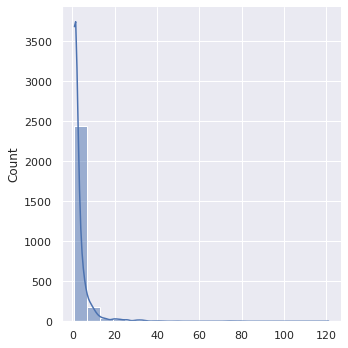

In [19]:
sns.displot(time_duration_ls, bins=20, kde=True);

In [16]:
print(np.max(time_duration_ls))

121


In [17]:
indices_time_duration = [i for i, x in enumerate(time_duration_ls) if x >= 45]

In [31]:
print(indices_time_duration)

for i in indices_time_duration:
    print(time_duration_ls[i])
    print(label_ls[i])

[73, 207, 458, 465, 2284]
49
74
75
208
73
459
121
466
79
2285


In [36]:
my_xarray_rel.duration[459].data

array(2)

In [37]:
my_xarray_rel.time_begin[459].data

array(datetime.date(1868, 5, 1), dtype=object)

In [38]:
my_xarray_rel.time_end[459].data

array(datetime.date(1868, 6, 1), dtype=object)

In [39]:
my_xarray_rel.duration[466].data

array(4)

In [40]:
my_xarray_rel.time_begin[466].data

array(datetime.date(1868, 7, 1), dtype=object)

In [41]:
my_xarray_rel.time_end[466].data

array(datetime.date(1868, 10, 1), dtype=object)

In [42]:
my_xarray_rel.duration[208].data

array(datetime.date(1859, 8, 1), dtype=object)

In [43]:
my_xarray_rel.time_begin[208].data

array(datetime.date(1859, 8, 1), dtype=object)

In [44]:
my_xarray_rel.time_end[208].data

array(datetime.date(1859, 8, 1), dtype=object)

In [20]:
%%time
# Compare with similar MHW from the other method
datem_year = []; datem_month = []; index_compare = []

for i in range(2717):
    
    date_try = str(my_xarray_rel.time_begin_ls[i].data)
    datem = datetime.datetime.strptime(date_try, "%Y-%m-%d %H:%M:%S")
    
    datem_year.append(datem.year)
    datem_month.append(datem.month)
    index_compare.append(i)

CPU times: user 353 ms, sys: 0 ns, total: 353 ms
Wall time: 362 ms


In [28]:
pandas_df = pd.DataFrame(zip(datem_year, datem_month, index_compare), columns = ['year', 'month', 'index'])

In [29]:
shortened_by_year = pandas_df.loc[pandas_df['year'] == 1861]

In [30]:
shortened_by_month = shortened_by_year.loc[shortened_by_year['month'] == 1]

In [31]:
shortened_by_month # these are the indices that I am interested in plotting

,year,month,index
236,1861,1,236
237,1861,1,237


In [56]:
my_xarray_rel.duration[236].data

array(4)

In [57]:
my_xarray_rel.duration[237].data

array(7)

In [92]:
mhw_id = 2285.
mhw_event_rel = combined_rel.where(combined_rel.labels==mhw_id, drop=False)
mhw_event_rel_true_drop = combined_rel.where(combined_rel.labels==mhw_id, drop=True)

In [93]:
datetimeindex_blobs_rel_rel = mhw_event_rel_true_drop.indexes['time'].to_datetimeindex()

In [94]:
datetimeindex_blobs = mhw_event_rel.indexes['time'].to_datetimeindex()

In [95]:
begin_year = datetimeindex_blobs_rel_rel[0].year
begin_month = datetimeindex_blobs_rel_rel[0].month

In [96]:
end_year = datetimeindex_blobs_rel_rel[-1].year
end_month = datetimeindex_blobs_rel_rel[-1].month

In [97]:
begin_time_index = get_time_index(begin_year, begin_month)
end_time_index = get_time_index(end_year, end_month)

In [98]:
print(begin_year, begin_month)
print(end_year, end_month)

1940 10
1947 4


VISUAL ANALYSIS: Look at one marine heatwave and compare

In [99]:
end_time_index

1166

In [100]:
begin_time_index

1088

In [101]:
from matplotlib.patches import Rectangle

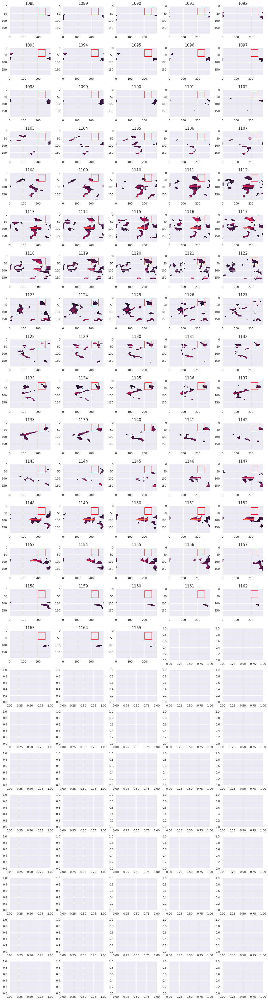

In [102]:
# MHW ID 208
fig, axs = plt.subplots(24,5, figsize=(18, 72), facecolor='w', edgecolor='k')

# fig, axs = plt.subplots(18,5, figsize=(18, 54), facecolor='w', edgecolor='k')
fig.subplots_adjust(hspace = .3, wspace=.3)

axs = axs.ravel()

for i in range(end_time_index-begin_time_index):
    mhw_event_slice = mhw_event_rel.__xarray_dataarray_variable__[begin_time_index+i,:,:]
    mhw_event_slice = mhw_event_rel.__xarray_dataarray_variable__[begin_time_index+i,:,:]
    axs[i].imshow(mhw_event_slice, vmin=0,vmax=5)
    axs[i].add_patch(Rectangle((lon_lim_less, lat_lim_less), lon_lim_great - lon_lim_less, lat_lim_great-lat_lim_less,facecolor='None', edgecolor='red'))
    axs[i].set_title(str(begin_time_index+i),fontsize=15)

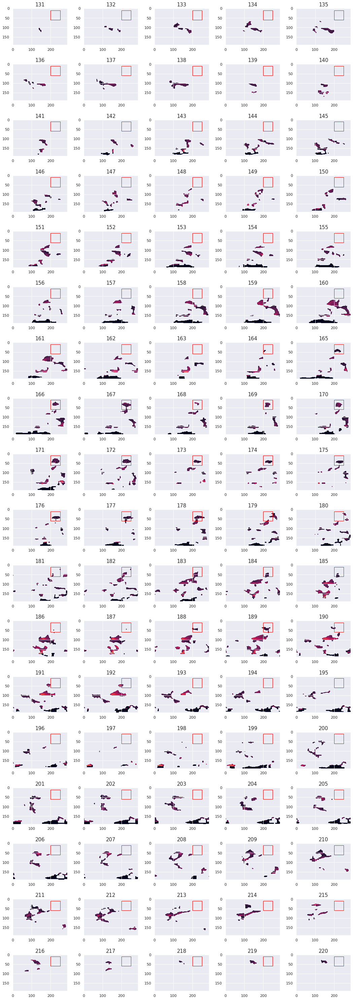

In [125]:
# from ensemble mean method
fig, axs = plt.subplots(18,5, figsize=(18, 54), facecolor='w', edgecolor='k')
fig.subplots_adjust(hspace = .3, wspace=.3)

axs = axs.ravel()

for i in range(end_time_index-begin_time_index):
    mhw_event_slice = mhw_event.SST[begin_time_index+i,:,:]
    mhw_event_slice = mhw_event.SST[begin_time_index+i,:,:]
    axs[i].imshow(mhw_event_slice, vmin=0,vmax=5)
    axs[i].add_patch(Rectangle((lon_lim_less, lat_lim_less), lon_lim_great - lon_lim_less, lat_lim_great-lat_lim_less,facecolor='None', edgecolor='red'))
    axs[i].set_title(str(begin_time_index+i),fontsize=15)

### Scratch work below

In [104]:
mhw_id = 506.
file = blobby_relative_em0
mhw_event = file.where(file.labels==mhw_id, drop=False)
mhw_event_true_drop = file.where(file.labels==mhw_id, drop=True)

datetimeindex_blobs_rel = mhw_event_true_drop.indexes['time'].to_datetimeindex()
datetimeindex_blobs = mhw_event.indexes['time'].to_datetimeindex()

begin_year = datetimeindex_blobs_rel[0].year
begin_month = datetimeindex_blobs_rel[0].month

end_year = datetimeindex_blobs_rel[-1].year
end_month = datetimeindex_blobs_rel[-1].month

begin_time_index = get_time_index(begin_year, begin_month)
end_time_index = get_time_index(end_year, end_month)

print(begin_time_index)
print(end_time_index)

245
245


In [103]:
print(end_year)
print(begin_month)

1853
5


In [16]:
air2d = blobby_ensemble_mean_em0.sel(blobby_ensemble_mean_em0.labels==992.)
air2d = blobby_ensemble_mean_em0_limited.where(blobby_ensemble_mean_em0.labels == 506.0)
air2d

# use that going forward

ValueError: the first argument to .sel must be a dictionary

In [17]:
# blobby_ensemble_mean_em0_limited = blobby_ensemble_mean_em0.where((blobby_ensemble_mean_em0.lat >= lat_lim_less) & (blobby_ensemble_mean_em0.lat <= lat_lim_great)&(blobby_ensemble_mean_em0.lon >= lon_lim_less) & (blobby_ensemble_mean_em0.lon <= lon_lim_great),drop=True)

air2d = blobby_ensemble_mean_em0.sel(blobby_ensemble_mean_em0.labels==506.)
################################# Match the dates (central of the data)
################################# Look for the date with the least number of events
################################# Looking for the largest event

air2d = blobby_ensemble_mean_em0_limited.where(blobby_ensemble_mean_em0.labels == 68.0, drop=True)
air2d

# N = 8
# for i in range(28):
#     fig, ax = plt.subplots(N, N, figsize=(8, 8))
#     for i in range(N):
#         for j in range(N):
#             ax[i,j].imshow(air2d[i,:,:])
#             ax[i,j].axis("off")
new = air2d.labels
fig = plt.figure(figsize=(15, 15), dpi=400)

plt.subplot(4, 3, 1)
new[1,:,:].plot()

plt.subplot(4, 3, 2)
new[2,:,:].plot()

plt.subplot(4, 3, 3)
new[3,:,:].plot()

plt.subplot(4, 3, 4)
new[4,:,:].plot()

plt.subplot(4, 3, 5)
new[5,:,:].plot()

plt.subplot(4, 3, 6)
new[6,:,:].plot()

plt.subplot(4, 3, 7)
new[7,:,:].plot()

plt.subplot(4, 3, 8)
new[8,:,:].plot()

plt.subplot(4, 3, 9)
new[9,:,:].plot()

plt.subplot(4, 3, 10)
new[10,:,:].plot()

plt.show()
# new[2,:,:].plot()
# plt.show()
# new[3,:,:].plot()
# plt.show()
# new[4,:,:].plot()
# plt.show()
# new[5,:,:].plot()
# plt.show()
# new[6,:,:].plot()
# plt.show()

# for i in range(len(39)):
#     air2d.labels[i,:,:]
    
# trying some things here
# datetimeindex_blobs = blobby_ensemble_mean_em0.indexes['time'].to_datetimeindex()
# print(datetimeindex_blobs)

# blobs['time'] = datetimeindex_blobs

# blobby_ensemble_mean_em0.sel(time=slice('02-01-1850', '06-01-1850'))#.plot()#.plot(col='time', col_wrap=4)

# air2d = blobby_ensemble_mean_em0.sel(time=slice('02-01-1850'))
# print(air2d)
# xr.DataArray.plot.imshow(air2d)
# da_stdn.plot(air2d)#.plot()

ValueError: the first argument to .sel must be a dictionary

In [6]:
# load SST anomaly data
SSTA_full = xr.open_dataset('/glade/work/cassiacai/SSTA_full.nc')  # from using ensemble mean
first_10_members_SSTA = SSTA_full.isel(member_id = [0,1,2,3,4,5,6,7,8,9])

SSTA_itself_ens0 = xr.open_dataset('detrended_ens0.nc') # from ensemble member 0 using linearly detrended SST

In [7]:
SSTA_itself_ens0

<xarray.Dataset>
Dimensions:                        (lat: 192, lon: 288, time: 1980)
Coordinates:
  * lat                            (lat) float64 -90.0 -89.06 ... 89.06 90.0
  * lon                            (lon) float64 0.0 1.25 2.5 ... 357.5 358.8
  * time                           (time) object 1850-02-01 00:00:00 ... 2015...
    member_id                      object ...
Data variables:
    __xarray_dataarray_variable__  (time, lat, lon) float64 ...

In [8]:
%%time
    
combined = xr.combine_by_coords([first_10_members_SSTA.isel(member_id = 0),blobby_ensemble_mean_em0])
combined_NEP = combined.where((combined.lat >= lat_lim_less) & (combined.lat <= lat_lim_great)&(combined.lon >= lon_lim_less) & (combined.lon <= lon_lim_great),drop=True)
    
event_NEP = combined_NEP.groupby(combined_NEP.labels) # 200 groups with labels 68.0, 148.0, ..., 4.616e+03.

CPU times: user 436 ms, sys: 229 ms, total: 665 ms
Wall time: 4.12 s


In [9]:
%%time
    
combined_rel = xr.combine_by_coords([SSTA_itself_ens0, blobby_relative_em0])
combined_NEP_rel = combined_rel.where((combined_rel.lat >= lat_lim_less) & (combined_rel.lat <= lat_lim_great)&(combined_rel.lon >= lon_lim_less) & (combined_rel.lon <= lon_lim_great),drop=True)
    
event_NEP_rel = combined_NEP_rel.groupby(combined_NEP_rel.labels) # 140 groups with labels 6.0, 19.0, ..., 2.695e+03.

CPU times: user 450 ms, sys: 183 ms, total: 632 ms
Wall time: 1.4 s


In [10]:
# extract data event_NEP_rel
file = event_NEP_rel

label_ls = []; time_begin_ls = []; time_end_ls = []; duration_ls = []; 
intense_mean = []; intense_max = []; intense_min = [];intense_cumu = []
coords_ls = []; cell_area_ls = []; lat_ls = []; lon_ls = []

for l, ent in file:        
    label_ls.append(l)
    groupedby_by_time = ent.groupby(ent.time)
    time_begin = str(ent.time[0].values); time_begin_ls.append(time_begin)
    time_end = str(ent.time[-1].values); time_end_ls.append(time_end)
        
    duration = len(ent.groupby("time")); duration_ls.append(duration)

    temp_intense_mean = []; temp_intense_max = []; temp_intense_min = []; temp_intense_cumu = []
    temp_coords = []; temp_cell_area = []; temp_lat = []; temp_lon = []
    for n, gro in groupedby_by_time:
        lat = gro.lat.values
        lon = gro.lon.values
        time = gro.time.values
                        
        intensity_mean_val = gro['__xarray_dataarray_variable__'].values.mean(); temp_intense_mean.append(intensity_mean_val)
        intensity_max_val = gro['__xarray_dataarray_variable__'].values.max(); temp_intense_max.append(intensity_max_val)
        intensity_min_val = gro['__xarray_dataarray_variable__'].values.min(); temp_intense_min.append(temp_intense_min)
        intensity_cumulative_val = gro['__xarray_dataarray_variable__'].values.sum(); temp_intense_cumu.append(intensity_cumulative_val)

        coords = list(zip(lat, lon)); temp_coords.append(coords)
        temp_lat.append(lat); temp_lon.append(lon)
        y,x=zip(*coords)
        dlon = [np.cos(y[c]*np.pi/180)*(111.320*1) for c in np.arange(0, len(coords))]
        dlat = (110.574 *1) * np.ones(len(dlon))
        cell_area = [np.sum(dlon[c]*dlat[c]) for c in np.arange(0, len(coords))]; temp_cell_area.append(np.sum(cell_area))

    intense_mean.append(temp_intense_mean)
    intense_max.append(temp_intense_max)
    intense_min.append(temp_intense_min) 
    intense_cumu.append(temp_intense_cumu)
    coords_ls.append(temp_coords)
    cell_area_ls.append(temp_cell_area)
    lat_ls.append(temp_lat)
    lon_ls.append(temp_lon)
        
    begin_dates_list = [dt.datetime.strptime(date, '%Y-%m-%d %H:%M:%S').date() for date in time_begin_ls]
    
    end_dates_list = [dt.datetime.strptime(date, '%Y-%m-%d %H:%M:%S').date() for date in time_end_ls]

my_df_rel = pd.DataFrame(zip(label_ls, begin_dates_list, end_dates_list, duration_ls,
                         intense_mean, intense_max, intense_min, intense_cumu,
                         coords_ls, cell_area_ls, lat_ls, lon_ls), 
                     columns = ['label', 'time_begin', 'time_end', 'duration',
                                'intense_mean', 'intense_max', 'intense_min','intense_cumu',
                                'coords','cell_area','lat','lon'])

my_xarray_rel = my_df_rel.to_xarray() 

In [11]:
# extract data event_NEP
file = event_NEP

label_ls = []; time_begin_ls = []; time_end_ls = []; duration_ls = []; 
intense_mean = []; intense_max = []; intense_min = [];intense_cumu = []
coords_ls = []; cell_area_ls = []; lat_ls = []; lon_ls = []

for l, ent in file:        
    label_ls.append(l)
    groupedby_by_time = ent.groupby(ent.time)
    time_begin = str(ent.time[0].values); time_begin_ls.append(time_begin)
    time_end = str(ent.time[-1].values); time_end_ls.append(time_end)
        
    duration = len(ent.groupby("time")); duration_ls.append(duration)

    temp_intense_mean = []; temp_intense_max = []; temp_intense_min = []; temp_intense_cumu = []
    temp_coords = []; temp_cell_area = []; temp_lat = []; temp_lon = []
    for n, gro in groupedby_by_time:
        lat = gro.lat.values
        lon = gro.lon.values
        time = gro.time.values
                        
        intensity_mean_val = gro['SST'].values.mean(); temp_intense_mean.append(intensity_mean_val)
        intensity_max_val = gro['SST'].values.max(); temp_intense_max.append(intensity_max_val)
        intensity_min_val = gro['SST'].values.min(); temp_intense_min.append(temp_intense_min)
        intensity_cumulative_val = gro['SST'].values.sum(); temp_intense_cumu.append(intensity_cumulative_val)

        coords = list(zip(lat, lon)); temp_coords.append(coords)
        temp_lat.append(lat); temp_lon.append(lon)
        y,x=zip(*coords)
        dlon = [np.cos(y[c]*np.pi/180)*(111.320*1) for c in np.arange(0, len(coords))]
        dlat = (110.574 *1) * np.ones(len(dlon))
        cell_area = [np.sum(dlon[c]*dlat[c]) for c in np.arange(0, len(coords))]; temp_cell_area.append(np.sum(cell_area))

    intense_mean.append(temp_intense_mean)
    intense_max.append(temp_intense_max)
    intense_min.append(temp_intense_min) 
    intense_cumu.append(temp_intense_cumu)
    coords_ls.append(temp_coords)
    cell_area_ls.append(temp_cell_area)
    lat_ls.append(temp_lat)
    lon_ls.append(temp_lon)
        
    begin_dates_list = [dt.datetime.strptime(date, '%Y-%m-%d %H:%M:%S').date() for date in time_begin_ls]
    
    end_dates_list = [dt.datetime.strptime(date, '%Y-%m-%d %H:%M:%S').date() for date in time_end_ls]

my_df = pd.DataFrame(zip(label_ls, begin_dates_list, end_dates_list, duration_ls,
                         intense_mean, intense_max, intense_min, intense_cumu,
                         coords_ls, cell_area_ls, lat_ls, lon_ls), 
                     columns = ['label', 'time_begin', 'time_end', 'duration',
                                'intense_mean', 'intense_max', 'intense_min','intense_cumu',
                                'coords','cell_area','lat','lon'])
my_xarray = my_df.to_xarray() 

In [12]:
# now we have my_df and my_df_rel
# now we have my_xarray and my_xarray_rel
xarray_using = my_xarray
maximums = []; means = []; cumulatives = []; max_cell_area = []; durations = []
for i in range(len(xarray_using.intense_max)):
    maximums.append(np.nanmax(xarray_using.intense_max[i].item()))
    means.append(np.nanmax(xarray_using.intense_mean[i].item()))
    cumulatives.append(np.nanmax(xarray_using.intense_cumu[i].item()))
    max_cell_area.append(np.nanmax(xarray_using.cell_area[i].item()))
    durations.append(xarray_using.duration[i].item())
        
char_df = pd.DataFrame(zip(maximums, means, cumulatives, max_cell_area, durations), columns = ['intensity_max', 'intensity_mean', 'intensity_total', 'max_tot_cell_area','duration'])

xarray_using = my_xarray_rel
maximums_rel = []; means_rel = []; cumulatives_rel = []; max_cell_area_rel = []; durations_rel = []
for i in range(len(xarray_using.intense_max)):
    maximums_rel.append(np.nanmax(xarray_using.intense_max[i].item()))
    means_rel.append(np.nanmax(xarray_using.intense_mean[i].item()))
    cumulatives_rel.append(np.nanmax(xarray_using.intense_cumu[i].item()))
    max_cell_area_rel.append(np.nanmax(xarray_using.cell_area[i].item()))
    durations_rel.append(xarray_using.duration[i].item())

char_df_rel = pd.DataFrame(zip(maximums_rel, means_rel, cumulatives_rel, max_cell_area_rel, durations_rel), columns = ['intensity_max', 'intensity_mean', 'intensity_total', 'max_tot_cell_area','duration'])

In [13]:
%%time

max_all_q1 = np.quantile(maximums, 0.25); max_all_q2 = np.quantile(maximums, 0.5); max_all_q3 = np.quantile(maximums, 0.75)
max_all_q1_rel = np.quantile(maximums_rel, 0.25); max_all_q2_rel = np.quantile(maximums_rel, 0.5); max_all_q3_rel = np.quantile(maximums_rel, 0.75)

mean_all_q1 = np.quantile(means, 0.25); mean_all_q2 = np.quantile(means, 0.5); mean_all_q3 = np.quantile(means, 0.75)
mean_all_q1_rel = np.quantile(means_rel, 0.25); mean_all_q2_rel = np.quantile(means_rel, 0.5); mean_all_q3_rel = np.quantile(means_rel, 0.75)

ic_all_q1 = np.quantile(cumulatives, 0.25); ic_all_q2 = np.quantile(cumulatives, 0.5); ic_all_q3 = np.quantile(cumulatives, 0.75)
ic_all_q1_rel = np.quantile(cumulatives_rel, 0.25); ic_all_q2_rel = np.quantile(cumulatives_rel, 0.5); ic_all_q3_rel = np.quantile(cumulatives_rel, 0.75)

mca_all_q1 = np.quantile(max_cell_area, 0.25); mca_all_q2 = np.quantile(max_cell_area, 0.5); mca_all_q3 = np.quantile(max_cell_area, 0.75)
mca_all_q1_rel = np.quantile(max_cell_area_rel, 0.25); mca_all_q2_rel = np.quantile(max_cell_area_rel, 0.5); mca_all_q3_rel = np.quantile(max_cell_area_rel, 0.75)

dur_all_q1 = np.quantile(durations, 0.25); dur_all_q2 = np.quantile(durations, 0.5); dur_all_q3 = np.quantile(durations, 0.75)
dur_all_q1_rel = np.quantile(durations_rel, 0.25); dur_all_q2_rel = np.quantile(durations_rel, 0.5); dur_all_q3_rel = np.quantile(durations_rel, 0.75)


CPU times: user 3.25 ms, sys: 0 ns, total: 3.25 ms
Wall time: 3.26 ms


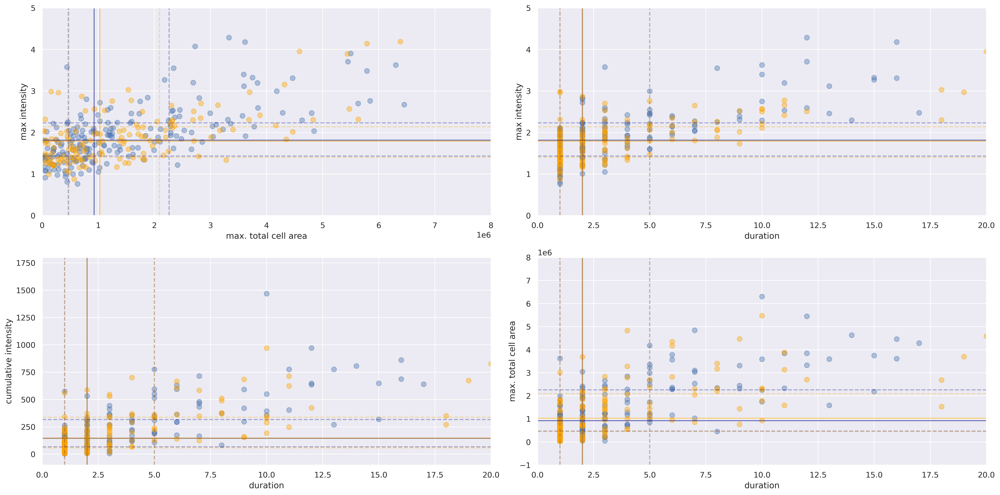

In [14]:
fig = plt.figure(figsize=(20, 10), dpi=400)

plt.subplot(2, 2, 1)
plt.axhline(y=max_all_q1,alpha=0.3,c='navy',linestyle='dashed'); plt.axhline(y=max_all_q2,alpha=0.5,c='navy'); plt.axhline(y=max_all_q3,alpha=0.3,c='navy',linestyle='dashed')
plt.axvline(x=mca_all_q1,alpha=0.3,c='navy',linestyle='dashed'); plt.axvline(x=mca_all_q2,alpha=0.5,c='navy'); plt.axvline(x=mca_all_q3,alpha=0.3,c='navy',linestyle='dashed')

plt.axhline(y=max_all_q1_rel,alpha=0.3,c='orange',linestyle='dashed'); plt.axhline(y=max_all_q2_rel,alpha=0.5,c='orange'); plt.axhline(y=max_all_q3_rel,alpha=0.3,c='orange',linestyle='dashed')
plt.axvline(x=mca_all_q1_rel,alpha=0.3,c='orange',linestyle='dashed'); plt.axvline(x=mca_all_q2_rel,alpha=0.5,c='orange'); plt.axvline(x=mca_all_q3_rel,alpha=0.3,c='orange',linestyle='dashed')

plt.scatter(max_cell_area, maximums,alpha=0.4, s = 50)
plt.scatter(max_cell_area_rel, maximums_rel,alpha=0.4, s = 50, color='orange')
plt.ylabel('max intensity'); plt.xlabel('max. total cell area')
plt.xlim(0,8e6); plt.ylim(0,5)

# # --------------------------------------------------------------
plt.subplot(2, 2, 2)
plt.axhline(y=max_all_q1,alpha=0.3,c='navy',linestyle='dashed'); plt.axhline(y=max_all_q2,alpha=0.5,c='navy'); plt.axhline(y=max_all_q3,alpha=0.3,c='navy',linestyle='dashed')
plt.axvline(x=dur_all_q1,alpha=0.3,c='navy',linestyle='dashed'); plt.axvline(x=dur_all_q2,alpha=0.5,c='navy'); plt.axvline(x=dur_all_q3,alpha=0.3,c='navy',linestyle='dashed')

plt.axhline(y=max_all_q1_rel,alpha=0.3,c='orange',linestyle='dashed'); plt.axhline(y=max_all_q2_rel,alpha=0.5,c='orange'); plt.axhline(y=max_all_q3_rel,alpha=0.3,c='orange',linestyle='dashed')
plt.axvline(x=dur_all_q1_rel,alpha=0.3,c='orange',linestyle='dashed'); plt.axvline(x=dur_all_q2_rel,alpha=0.5,c='orange'); plt.axvline(x=dur_all_q3_rel,alpha=0.3,c='orange',linestyle='dashed')

plt.scatter(durations, maximums ,alpha=0.4, s = 50)
plt.scatter(durations_rel, maximums_rel ,alpha=0.4, s = 50, color='orange')
plt.ylabel('max intensity'); plt.xlabel('duration')
plt.xlim(0,dur_all_q3*4); plt.ylim(0,5)

# # --------------------------------------------------------------
plt.subplot(2, 2, 3)
plt.axhline(y=ic_all_q1,alpha=0.3,c='navy', linestyle='dashed'); plt.axhline(y=ic_all_q2,alpha=0.5,c='navy'); plt.axhline(y=ic_all_q3,alpha=0.3,c='navy', linestyle='dashed')
plt.axvline(x=dur_all_q1,alpha=0.3,c='navy', linestyle='dashed'); plt.axvline(x=dur_all_q2,alpha=0.5,c='navy'); plt.axvline(x=dur_all_q3,alpha=0.3,c='navy',linestyle='dashed')

plt.axhline(y=ic_all_q1_rel,alpha=0.3,c='orange', linestyle='dashed'); plt.axhline(y=ic_all_q2_rel,alpha=0.5,c='orange'); plt.axhline(y=ic_all_q3_rel,alpha=0.3,c='orange', linestyle='dashed')
plt.axvline(x=dur_all_q1_rel,alpha=0.3,c='orange', linestyle='dashed'); plt.axvline(x=dur_all_q2_rel,alpha=0.5,c='orange'); plt.axvline(x=dur_all_q3_rel,alpha=0.3,c='orange',linestyle='dashed')

plt.scatter(durations, cumulatives ,alpha=0.4, s = 50)
plt.scatter(durations_rel, cumulatives_rel ,alpha=0.4, s = 50, color='orange')
plt.ylabel('cumulative intensity'); plt.xlabel('duration')
plt.xlim(0,dur_all_q3*4); plt.ylim(-100,1800)
# # --------------------------------------------------------------
plt.subplot(2, 2, 4)
plt.axhline(y=mca_all_q1,alpha=0.3,c='navy', linestyle='dashed'); plt.axhline(y=mca_all_q2,alpha=0.5,c='navy'); plt.axhline(y=mca_all_q3,alpha=0.3,c='navy', linestyle='dashed')
plt.axvline(x=dur_all_q1,alpha=0.3,c='navy', linestyle='dashed'); plt.axvline(x=dur_all_q2,alpha=0.5,c='navy'); plt.axvline(x=dur_all_q3,alpha=0.3,c='navy',linestyle='dashed')

plt.axhline(y=mca_all_q1_rel,alpha=0.3,c='orange', linestyle='dashed'); plt.axhline(y=mca_all_q2_rel,alpha=0.5,c='orange'); plt.axhline(y=mca_all_q3_rel,alpha=0.3,c='orange', linestyle='dashed')
plt.axvline(x=dur_all_q1_rel,alpha=0.3,c='orange', linestyle='dashed'); plt.axvline(x=dur_all_q2_rel,alpha=0.5,c='orange'); plt.axvline(x=dur_all_q3_rel,alpha=0.3,c='orange',linestyle='dashed')

plt.scatter(durations, max_cell_area ,alpha=0.4, s = 50)
plt.scatter(durations_rel, max_cell_area_rel ,alpha=0.4, s = 50, color='orange')
plt.ylabel('max. total cell area'); plt.xlabel('duration')
plt.ylim(-1e6,8e6); plt.xlim(0,dur_all_q3*4);

plt.tight_layout()
plt.show()

In [15]:
datetimeindex_blobs = blobby_ensemble_mean_em0.indexes['time'].to_datetimeindex()
print(datetimeindex_blobs)

datetimeindex_blobs_rel = blobby_relative_em0.indexes['time'].to_datetimeindex()
print(datetimeindex_blobs_rel)

DatetimeIndex(['1850-02-01', '1850-03-01', '1850-04-01', '1850-05-01',
               '1850-06-01', '1850-07-01', '1850-08-01', '1850-09-01',
               '1850-10-01', '1850-11-01',
               ...
               '2014-04-01', '2014-05-01', '2014-06-01', '2014-07-01',
               '2014-08-01', '2014-09-01', '2014-10-01', '2014-11-01',
               '2014-12-01', '2015-01-01'],
              dtype='datetime64[ns]', length=1980, freq=None)
DatetimeIndex(['1850-02-01', '1850-03-01', '1850-04-01', '1850-05-01',
               '1850-06-01', '1850-07-01', '1850-08-01', '1850-09-01',
               '1850-10-01', '1850-11-01',
               ...
               '2014-04-01', '2014-05-01', '2014-06-01', '2014-07-01',
               '2014-08-01', '2014-09-01', '2014-10-01', '2014-11-01',
               '2014-12-01', '2015-01-01'],
              dtype='datetime64[ns]', length=1980, freq=None)


In [16]:
blobby_ensemble_mean_em0['time'] = datetimeindex_blobs
blobby_relative_em0['time'] = datetimeindex_blobs_rel

In [17]:
greater_than_10_months = my_xarray.where(my_xarray.duration > 10., drop=True)
greater_than_10_months

<xarray.Dataset>
Dimensions:       (index: 22)
Coordinates:
  * index         (index) int64 0 17 45 47 48 49 51 ... 118 132 171 186 193 199
Data variables:
    label         (index) float64 68.0 506.0 992.0 ... 4.502e+03 4.616e+03
    time_begin    (index) object 1851-12-01 1861-03-01 ... 2008-12-01 2006-03-01
    time_end      (index) object 1854-06-01 1866-01-01 ... 2011-07-01 2013-03-01
    duration      (index) float64 28.0 45.0 11.0 21.0 ... 17.0 25.0 25.0 33.0
    intense_mean  (index) object [1.3412186, 1.1474661, 1.3287985, 1.6017257,...
    intense_max   (index) object [1.6270447, 1.2498169, 1.6156311, 2.1660156,...
    intense_min   (index) object [[...], [...], [...], [...], [...], [...], [...
    intense_cumu  (index) object [81.81433, 13.769592, 74.41272, 110.51907, 2...
    coords        (index) object [[(30.6282722513089, 200.0), (30.62827225130...
    cell_area     (index) object [615654.1408304101, 123183.08837669097, 5602...
    lat           (index) object [array([30.62827225, 30.62827225, 30.6282722...
    lon           (index) object [array([200.  , 201.25, 202.5 , 200.  , 201....

In [87]:
id_68 = greater_than_10_months.where(greater_than_10_months.label > 68., drop=True)
id_68

<xarray.Dataset>
Dimensions:       (index: 21)
Coordinates:
  * index         (index) int64 17 45 47 48 49 51 52 ... 118 132 171 186 193 199
Data variables:
    label         (index) float64 506.0 992.0 1.071e+03 ... 4.502e+03 4.616e+03
    time_begin    (index) object 1861-03-01 1885-01-01 ... 2008-12-01 2006-03-01
    time_end      (index) object 1866-01-01 1885-11-01 ... 2011-07-01 2013-03-01
    duration      (index) float64 45.0 11.0 21.0 13.0 ... 17.0 25.0 25.0 33.0
    intense_mean  (index) object [0.9429838, 0.8282443, 1.3498541, 1.5120726,...
    intense_max   (index) object [1.1600952, 0.97802734, 1.6192932, 1.9537964...
    intense_min   (index) object [[...], [...], [...], [...], [...], [...], [...
    intense_cumu  (index) object [58.464996, 64.60306, 70.19241, 290.31793, 2...
    coords        (index) object [[(30.6282722513089, 223.75), (30.6282722513...
    cell_area     (index) object [644628.1950324033, 813571.1823049551, 43082...
    lat           (index) object [array([30.62827225, 30.62827225, 30.6282722...
    lon           (index) object [array([223.75, 225.  , 226.25, 227.5 , 228....

In [ ]:
# greater_than_10_months

In [18]:
greater_than_10_months_rel = my_xarray_rel.where(my_xarray_rel.duration > 10., drop=True)
greater_than_10_months_rel

<xarray.Dataset>
Dimensions:       (index: 13)
Coordinates:
  * index         (index) int64 23 24 38 44 45 51 63 81 84 88 100 103 114
Data variables:
    label         (index) float64 459.0 466.0 814.0 ... 2.13e+03 2.285e+03
    time_begin    (index) object 1863-03-01 1868-12-01 ... 1938-02-01 1941-11-01
    time_end      (index) object 1865-10-01 1877-10-01 ... 1940-02-01 1945-09-01
    duration      (index) float64 26.0 40.0 19.0 20.0 ... 18.0 11.0 23.0 41.0
    intense_mean  (index) object [1.0299800731932267, 1.1483168880445442, 1.2...
    intense_max   (index) object [1.1983942686646856, 1.3829284436816351, 1.5...
    intense_min   (index) object [[...], [...], [...], [...], [...], [...], [...
    intense_cumu  (index) object [79.30846563587846, 158.4677305501471, 255.7...
    coords        (index) object [[(36.282722513089006, 200.0), (36.282722513...
    cell_area     (index) object [710743.4796710974, 1248805.6850063307, 1937...
    lat           (index) object [array([36.28272251, 36.28272251, 36.2827225...
    lon           (index) object [array([200.  , 201.25, 202.5 , 203.75, 200....

## Statistics

In [54]:
def power_law(x, a, b):
    return a * np.power(x, -b)

def cumulative_probability(C, alpha, xdata):
    exp_use = alpha - 1
    cprob = (C /exp_use)*(xdata**(-exp_use))
    return cprob

def NormalizeData(data): # Normalizing # might need to use this.
    return (data - np.nanmin(data)) / (np.nanmax(data) - np.nanmin(data))

In [55]:
from pylab import *; from scipy import *; from scipy import optimize

In [66]:
grouped_df_mean = my_df.groupby('duration').mean()
grouped_df_std = my_df.groupby('duration').std()

freq_count_dur = my_df['duration'].value_counts(normalize=True)
freq_count_dur_sorted = freq_count_dur.sort_index()

freq_count_dur_notnormed = my_df['duration'].value_counts()
freq_count_dur_not_normed_sorted = freq_count_dur_notnormed.sort_index()

#Attempt 1
index_list = freq_count_dur_sorted.index + 1
freq_list = freq_count_dur_sorted.values

# ------------------------------------------------------------------
xdata=index_list
ydata=freq_list

logx = log10(xdata)
logy = log10(ydata)

# define our (line) fitting function
fitfunc = lambda p, x: p[0] + p[1] * x
errfunc = lambda p, x, y: (y - fitfunc(p, x))

pinit = [1.0, -1.0]
out = optimize.leastsq(errfunc, pinit, args=(logx, logy), full_output=1)

pfinal = out[0]
covar = out[1]

index = pfinal[1]
amp = 10.0**pfinal[0]

print ('amp:',amp, 'index', index)

powerlaw = lambda x, amp, index: amp * (x**index)

amp: 0.49069135646189893 index -1.367196779814973


In [67]:
nprange = np.arange(np.nanmin(index_list),np.nanmax(index_list))

In [68]:
C_SO = amp; alpha_SO = abs(index)

# xdata = index_list
xdata = nprange
cprob_SO = cumulative_probability(C_SO, alpha_SO, xdata)
y_SO = amp*nprange**(-abs(index))

In [71]:
grouped_df_mean_rel = my_df_rel.groupby('duration').mean()
grouped_df_std_rel = my_df_rel.groupby('duration').std()

freq_count_dur_rel = my_df_rel['duration'].value_counts(normalize=True)
freq_count_dur_sorted_rel = freq_count_dur_rel.sort_index()

freq_count_dur_notnormed_rel = my_df_rel['duration'].value_counts()
freq_count_dur_not_normed_sorted_rel = freq_count_dur_notnormed_rel.sort_index()

#Attempt 1
index_list_rel = freq_count_dur_sorted_rel.index + 1
freq_list_rel = freq_count_dur_sorted_rel.values

# ------------------------------------------------------------------
xdata=index_list_rel
ydata=freq_list_rel

logx = log10(xdata)
logy = log10(ydata)

# define our (line) fitting function
fitfunc = lambda p, x: p[0] + p[1] * x
errfunc = lambda p, x, y: (y - fitfunc(p, x))

pinit = [1.0, -1.0]
out = optimize.leastsq(errfunc, pinit, args=(logx, logy), full_output=1)

pfinal = out[0]
covar = out[1]

index = pfinal[1]
amp = 10.0**pfinal[0]

print ('amp:',amp, 'index', index)

powerlaw = lambda x, amp, index: amp * (x**index)

amp: 0.5090383599857105 index -1.2854612095580293


In [72]:
nprange_rel = np.arange(np.nanmin(index_list_rel),np.nanmax(index_list_rel))

In [79]:
C_SO_rel = amp; alpha_SO_rel = abs(index)

# xdata = index_list
xdata_rel = nprange_rel
cprob_SO_rel = cumulative_probability(C_SO_rel, alpha_SO_rel, xdata_rel)
y_SO_rel = amp*nprange_rel**(-abs(index))

In [80]:
print(len(nprange_rel))
print(len(cprob_SO_rel))

print(len(nprange))
print(len(cprob_SO))

40
40
44
44


CPU times: user 59.6 ms, sys: 990 µs, total: 60.6 ms
Wall time: 67.9 ms


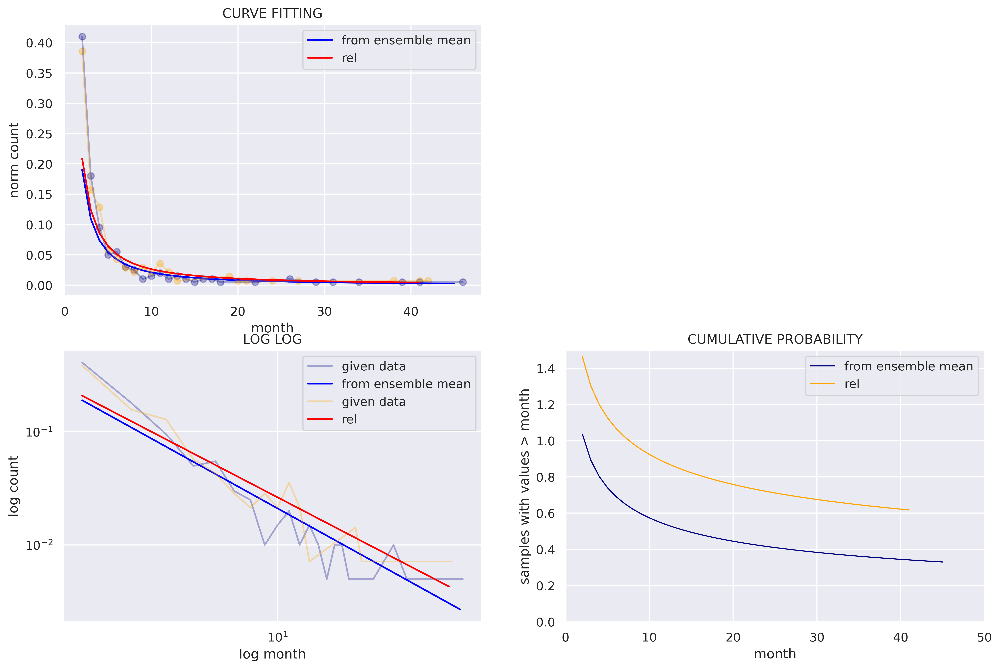

In [81]:
%%time

fig = plt.figure(figsize=(15, 10), dpi=400)

plt.subplot(2, 2, 1)
plt.title('CURVE FITTING')

plt.plot(index_list, freq_list,color='navy',alpha=0.3)
plt.scatter(index_list, freq_list,color='navy',alpha=0.3)
plt.plot(nprange,y_SO, label = 'from ensemble mean',color='blue')

plt.plot(index_list_rel, freq_list_rel,color='orange',alpha=0.3)
plt.scatter(index_list_rel, freq_list_rel,color='orange',alpha=0.3)
plt.plot(nprange_rel,y_SO_rel, label = 'rel',color='red')

plt.xlabel('month'); plt.ylabel('norm count')
plt.legend()

plt.subplot(2, 2, 3)
plt.title('LOG LOG')
plt.loglog(index_list, freq_list, label='given data',color='navy',alpha=0.3)
plt.loglog(nprange,y_SO, label = 'from ensemble mean',color='blue')

plt.loglog(index_list_rel, freq_list_rel, label='given data',color='orange',alpha=0.3)
plt.loglog(nprange_rel,y_SO_rel, label = 'rel',color='red')

plt.ylabel('log count'); plt.xlabel('log month')
plt.legend()

plt.subplot(2, 2, 4)
plt.title('CUMULATIVE PROBABILITY')
plt.plot(nprange, cprob_SO, c='navy', linewidth = 1, label='from ensemble mean')
plt.plot(nprange_rel, cprob_SO_rel, c='orange', linewidth = 1, label='rel')
plt.ylabel('samples with values > month'); plt.xlabel('month')
plt.xlim(0,50); plt.ylim(0.0,1.5)
plt.legend()

plt.show()